In [1]:
import numpy as np
import pandas as pd
import scipy.io

import matplotlib.pyplot as plt
import sys
sys.path.insert(0, '../')
from M1S_tools import *
import glob

plt.set_cmap('jet')

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
## bending modes & influence matrices etc from Buddy #####################
ML actuators =  165 165
Afn =  (6991, 165)
fv =  (165, 165)
U matrix (6991, 165)
N node =  6991
## bending modes & influence matrices etc from Trupti #####################
N actuators =  170
/Users/bxin/Library/CloudStorage/OneDrive-SharedLibraries-GMTOCorp/M1S Portal - Documents/influnce_matrix_files/OA_influence_matrices_all/OA_surface_normal_165SA_09Jan2025/
Afz =  (27547, 165)
Afx =  (27547, 165)
Afy =  (27547, 165)
U

<Figure size 640x480 with 0 Axes>

In [2]:
#dateID = '250117' not using dateID. b/c the BMs were split onto quite a few days
TcompString = '' #default, no T compensation
#TcompString = 'comp'

In [3]:
#meaning to use those in folder "GMTO and ML BM 25 - 27"; 
#for ML BMs, modes 25-27 were only measured on that day. so set it as True
useReMeasured = True 

/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set1 10.2 5-7 ML bm1+ gmtMorph170614 -.h5: Tue Jan 28 11:12:11 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set1 10.2 5-7 ML bm1- gmtMorph170614 -.h5: Tue Jan 28 11:15:57 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set2 10.2 5-7 ML bm1- gmtMorph170614 -.h5: Tue Jan 28 11:19:13 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set2 10.2 5-7 ML bm1+ gmtMorph170614 -.h5: Tue Jan 28 11:23:09 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set1 10.2 5-7 ML bm2+ gmtMorph170614 -.h5: Tue Jan 28 11:35:13 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set1 10.2 5-7 ML bm2- gmtMorph170614 -.h5: Tue Jan 28 11:39:09 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 -

/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set1 10.2 5-7 ML bm16+ gmtMorph170614 -.h5: Tue Jan 28 15:32:51 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set1 10.2 5-7 ML bm16- gmtMorph170614 -.h5: Tue Jan 28 15:37:12 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set2 10.2 5-7 ML bm16- gmtMorph170614 -.h5: Tue Jan 28 15:40:30 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set2 10.2 5-7 ML bm16+ gmtMorph170614 -.h5: Tue Jan 28 15:44:26 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set1 10.2 5-7 ML bm17+ gmtMorph170614 -.h5: Tue Jan 28 15:48:12 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML BM 1 - 17/250128 GMT3 set1 10.2 5-7 ML bm17- gmtMorph170614 -.h5: Tue Jan 28 15:52:01 2025 
/Users/bxin/GMT_docs/1_M1/Analysis/ml_data/data/Optical Data/ML 

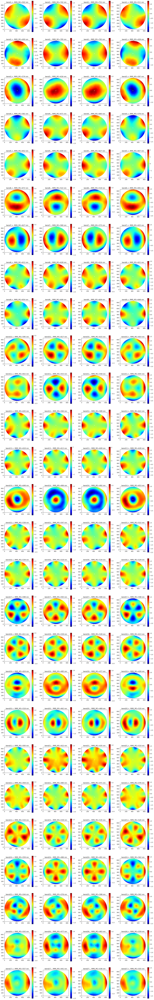

In [37]:
#look at all the +--+ maps, everything in h5 CS
startmode = 1
endmode = 27
nmode = endmode - startmode+1
ts_array = []
fig, ax = plt.subplots(nmode,4,figsize=(20,5*nmode))
i = 0
for modeID in range(startmode,endmode+1):
    signedBend = ['set1*bm%d+'%modeID, 'set1*bm%d-'%modeID, 'set2*bm%d-'%modeID, 'set2*bm%d+'%modeID]
    for bend in signedBend:
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        
        globstring = '%s/*ML BM*/*%s*.h5'%(ml_data_dir, bend) #not using dateID. Data split into 0117 and 0121
        if modeID>=25 and modeID<=27 and useReMeasured:
            bendModified = bend.replace('bm', 'ML bm')
            globstring = '%s/GMTO and ML BM 25 - 27/*%s*.h5'%(ml_data_dir, bendModified) #not using dateID. 
        #print(globstring)
        fileset = sorted(glob.glob(globstring))
        assert len(fileset)==1
        m1s,centerRow,centerCol,pixelSize, ts = readH5Map(fileset)
        ts_array.append(ts)
        m1rms = np.std(m1s[~np.isnan(m1s)])*1000 #convert into nm

        img = ax[irow][icol].imshow(m1s, origin='lower')
        fig.colorbar(img, ax=ax[irow][icol])
        ax[irow][icol].set_title('bend%d,%s, RMS_M1=%.0f nm'%(modeID, bend[-1], m1rms))

In [38]:
len(ts_array)/4

27.0

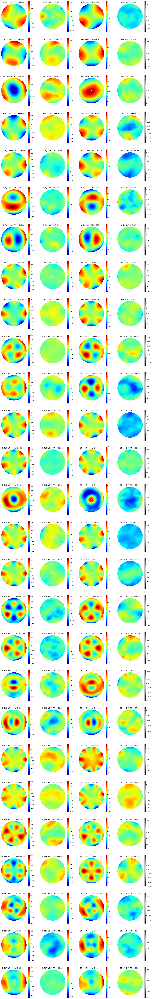

In [39]:
#look at average and diff of each ++ pair and each -- pair; all in h5 CS
stats = np.zeros((4, nmode))
fig, ax = plt.subplots(nmode,4,figsize=(20,5*nmode))
i = 0
for modeID in range(startmode,endmode+1):

    aveplus = np.zeros_like(m1s)
    aveminus = np.zeros_like(m1s)
    diffplus = np.zeros_like(m1s)
    diffminus = np.zeros_like(m1s)
    signedBend = ['set1*bm%d+'%modeID, 'set1*bm%d-'%modeID, 'set2*bm%d-'%modeID, 'set2*bm%d+'%modeID]
    signshort = '+--+'
    for bend in signedBend:

        globstring = '%s/*ML BM*/*%s*.h5'%(ml_data_dir, bend) #not using dateID. Data split into 0117 and 0121
        if modeID>=25 and modeID<=27 and useReMeasured:
            bendModified = bend.replace('bm', 'ML bm')
            globstring = '%s/GMTO and ML BM 25 - 27/*%s*.h5'%(ml_data_dir, bendModified) #not using dateID.         
        #print(globstring)
        fileset = sorted(glob.glob(globstring))
        #print(fileset)
        assert len(fileset)==1
        m1s,centerRow,centerCol,pixelSize, ts = readH5Map(fileset, verbose=False)
        if '+' in bend:
            aveplus += m1s
            if 'set1' in bend:
                diffplus -= m1s
            else:
                diffplus += m1s #set2 - set1
                aveplus /= 2
        else:
            aveminus += m1s
            if 'set1' in bend:
                diffminus -= m1s
            else:
                diffminus += m1s
                aveminus /= 2
    for j in range(4):
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        if j==0:
            m1s = aveplus
            img = ax[irow][icol].imshow(m1s, origin='lower')
            fig.colorbar(img, ax=ax[irow][icol])
            m1rms = np.std(m1s[~np.isnan(m1s)])*1000 #convert into nm
            mytitle = 'BM%d, +Mean, RMS=%.0f nm'%(modeID, m1rms)
        elif j==1:
            m1s = diffplus
            img = ax[irow][icol].imshow(m1s, origin='lower')
            fig.colorbar(img, ax=ax[irow][icol])
            m1rms = np.std(m1s[~np.isnan(m1s)])*1000 #convert into nm
            mytitle = 'BM%d, +Diff, RMS=%.0f nm'%(modeID, m1rms)           
        elif j==2:
            m1s = aveminus
            img = ax[irow][icol].imshow(m1s, origin='lower')
            fig.colorbar(img, ax=ax[irow][icol])
            m1rms = np.std(m1s[~np.isnan(m1s)])*1000 #convert into nm
            mytitle = 'BM%d, -Mean, RMS=%.0f nm'%(modeID, m1rms)
        elif j==3:
            m1s = diffminus
            img = ax[irow][icol].imshow(m1s, origin='lower')
            fig.colorbar(img, ax=ax[irow][icol])
            m1rms = np.std(m1s[~np.isnan(m1s)])*1000 #convert into nm
            mytitle = 'BM%d, -Diff, RMS=%.0f nm'%(modeID, m1rms)  
        ax[irow][icol].set_title(mytitle)
        ax[irow][icol].axis('off')
        stats[j, modeID-1-startmode+1] = m1rms

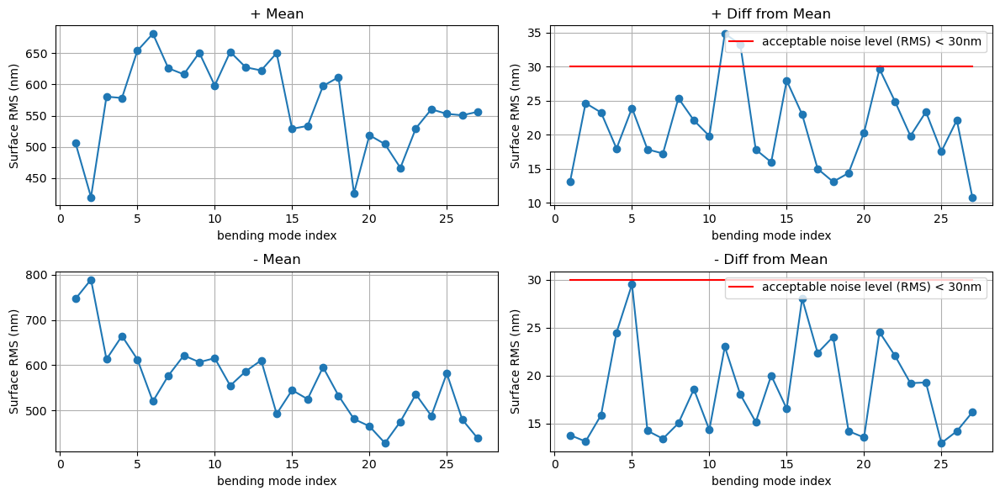

In [40]:
fig, ax = plt.subplots(2,2,figsize=(12, 6))
x0 = np.arange(startmode, endmode+1)
i = 0
j = 0
ax[i][j].plot(x0, stats[0,:],'-o')
ax[i][j].grid()
ax[i][j].set_xlabel('bending mode index')
ax[i][j].set_title('+ Mean')
ax[i][j].set_ylabel('Surface RMS (nm)')
i = 0
j = 1
ax[i][j].plot(x0, stats[j,:]/2,'-o')
ax[i][j].plot([startmode, endmode],[30,30],'-r', label='acceptable noise level (RMS) < 30nm')
ax[i][j].grid()
ax[i][j].legend(loc='upper right')
ax[i][j].set_xlabel('bending mode index')
ax[i][j].set_title('+ Diff from Mean')
ax[i][j].set_ylabel('Surface RMS (nm)')
i = 1
j = 0
ax[i][j].plot(x0, stats[2,:],'-o')
ax[i][j].grid()
ax[i][j].set_xlabel('bending mode index')
ax[i][j].set_title('- Mean')
ax[i][j].set_ylabel('Surface RMS (nm)')
i = 1
j = 1
ax[i][j].plot(x0, stats[3,:]/2,'-o')
ax[i][j].plot([startmode, endmode],[30,30],'-r', label='acceptable noise level (RMS) < 30nm')
ax[i][j].grid()
ax[i][j].legend(loc='upper right')
ax[i][j].set_xlabel('bending mode index')
ax[i][j].set_title('- Diff from Mean')
ax[i][j].set_ylabel('Surface RMS (nm)')
plt.tight_layout()

### Now calculate the measured BMs

In [41]:
df = pd.read_csv('../test_input_data/BM_amp_sec10.csv')
bmMags = np.array(df['  S RMS(nm)'])/1000.
bmMags[25-1] = 300/1000.
bmMags[26-1] = 200/1000. #changed in order to avoid actuator force limit (on the quads)
bmMags[27-1] = 120/1000. #changed in order to avoid actuator force limit (on the quads)

In [42]:
#in order to be able to compare to the GMT FEM BMs side by side, we change the sign of ML modes to match GMT
sign_MLBM_GMT = np.loadtxt('../model_data/sign_MLBM_GMT.txt')

# we are NOT modifying UMat_ml and VMat_ml. We use this sign flips on the fly when we need them
# otherwise it causes too much confusion when we refer to "Mirror lab bending modes"
if 0:
    for i in range(len(sign_MLBM_GMT)):
        UMat_ml[:,i] *= sign_MLBM_GMT[i]
        VMat_ml[:,i] *= sign_MLBM_GMT[i]

# sign_MLBM_GMT.txt was made after mode swap to match GMT FEM.
# now that we are not swapping the ML modes (that causes too much confusion too, when we refer to "ML BMs")
# below we make sign_MLBM_GMT match the ordering of GMT FEM, without mode swap
mode1, mode2 = 32, 33
sign_MLBM_GMT[[mode1-1, mode2-1]] = sign_MLBM_GMT[[mode2-1, mode1-1]]
mode1, mode2 = 36, 37
sign_MLBM_GMT[[mode1-1, mode2-1]] = sign_MLBM_GMT[[mode2-1, mode1-1]]

    #modes To Swap, to match the GMT BMs
    mode1, mode2 = 32, 33
    UMat_ml[:, [mode1-1, mode2-1]] = UMat_ml[:, [mode2-1, mode1-1]]
    VMat_ml[:, [mode1-1, mode2-1]] = VMat_ml[:, [mode2-1, mode1-1]]
    mode1, mode2 = 36, 37
    UMat_ml[:, [mode1-1, mode2-1]] = UMat_ml[:, [mode2-1, mode1-1]]
    VMat_ml[:, [mode1-1, mode2-1]] = VMat_ml[:, [mode2-1, mode1-1]]

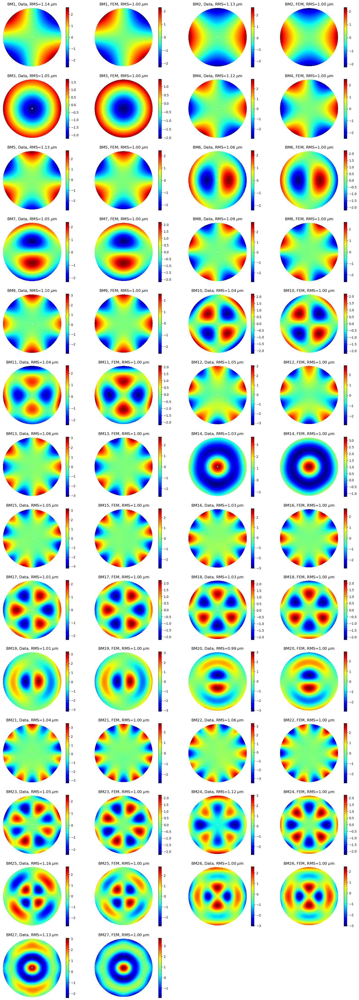

In [43]:
from scipy.interpolate import griddata

GMT_FEM = 0 #use ML FEM for side-by-side comparision with measured shapes

#GMT_FEM = 1 #ML FEM, this is used to show Afn@VMat_ml, just for a visual prediction
#The Afn_ml@VMat are not orthogonal, therefore cannot be used for decomposition.

#[x1, y1] are the x and y grid in M1B. 
#CenterCol and centerRow are swapped, because they were meant for h5 CS
#Lines below, we will transpose the h5 map to match this.
#.  we will also reverse the sign of h5 maps to be in M1B.
[x1, y1] = mkXYGrid(m1s, centerCol, centerRow, pixelSize)

myBM = np.zeros((Sxn, Syn, nmode))
nrow = int(np.ceil(nmode/2.))
fig, ax = plt.subplots(nrow,4,figsize=(20,4*nrow))

i = 0
for modeID in range(startmode,endmode+1):

    signedBend = ['set1*bm%d+'%modeID, 'set1*bm%d-'%modeID, 'set2*bm%d-'%modeID, 'set2*bm%d+'%modeID]
    signshort = '+--+'    
    for bend in signedBend:
        globstring = '%s/*ML BM*/*%s*-.h5'%(ml_data_dir,bend) #not using dateID. Data split into 0117 and 0121
        if modeID>=25 and modeID<=27 and useReMeasured:
            bendModified = bend.replace('bm', 'ML bm')
            globstring = '%s/GMTO and ML BM 25 - 27/*%s*.h5'%(ml_data_dir, bendModified) #not using dateID. 
        #print(globstring)
        fileset = sorted(glob.glob(globstring))
        #print(fileset)
        assert len(fileset)==1
        m1s,centerRow,centerCol,pixelSize, ts = readH5Map(fileset, verbose=False)
        #m1s *= -1 # we are converting into M1B with myBM[] below
        if '+' in bend:
            myBM[:,:,modeID-startmode] += m1s
        else:
            myBM[:,:,modeID-startmode] -= m1s
    myBM[:,:,modeID-startmode] /= (4*bmMags[modeID-1]) #normalize to 1um RMS surfaces
    myBM[:,:,modeID-startmode] = -myBM[:,:,modeID-startmode].T #convert into M1B
    myBM[:,:,modeID-startmode] *= sign_MLBM_GMT[modeID-1] #to be visually consistent with GMT modes
    m1s = myBM[:,:,modeID-startmode]
    m1rms = np.std(m1s[~np.isnan(m1s)])

    irow = np.int8(i/4)
    icol = np.mod(i,4)
    i += 1
    
    img = ax[irow][icol].imshow(m1s, origin='lower')
    fig.colorbar(img, ax=ax[irow][icol])
    mytitle = r'BM%d, Data, RMS=%.2f $\mu$m'%(modeID, m1rms)
    ax[irow][icol].set_title(mytitle)
    ax[irow][icol].axis('off')
    
    irow = np.int8(i/4)
    icol = np.mod(i,4)
    i += 1
    
    if not GMT_FEM: #ML FEM
        aa = UMat_ml[:,modeID-1]
        m1rms = np.std(aa[~np.isnan(aa)])
        grid_z = griddata((np.squeeze(nodex_ml), np.squeeze(nodey_ml)), 
                          sign_MLBM_GMT[modeID-1]*UMat_ml[:,modeID-1], (x1,y1), method='linear')
    else: #never tried yet
        ss_mlgrid = Afn_ml @ gmt165Fvec2mlFvec(VMat[:,modeID-1]) * 1e-3
        m1rms = np.std(ss_mlgrid[~np.isnan(ss_mlgrid)])
        grid_z = griddata((np.squeeze(nodex_ml), np.squeeze(nodey_ml)), ss_mlgrid, (x1,y1), method='linear')
    #img = ax[irow][icol].scatter(nodex, nodey,10, UMat[:,modeID-1]) #scatter makes image sampling bad
    img = ax[irow][icol].imshow(grid_z, origin='lower')
    
    ax[irow][icol].set_title(r'BM%d, FEM, RMS=%.2f $\mu$m'%(modeID,m1rms))
    ax[irow][icol].axis('equal')
    ax[irow][icol].axis('off')
    fig.colorbar(img, ax=ax[irow][icol])
    
for i in range(nmode*2, nrow*4):
    irow = np.int8(i/4)
    icol = np.mod(i,4)
    ax[irow][icol].axis('off')

(-0.5, 852.5, -0.5, 852.5)

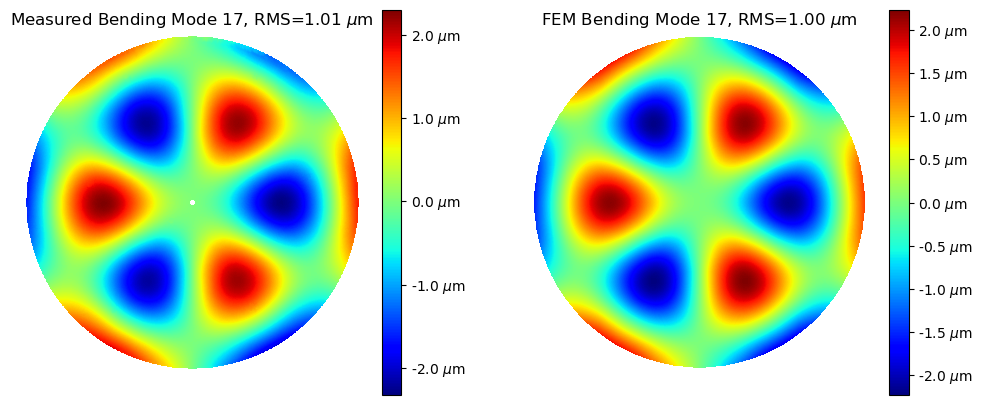

In [16]:
#make a plot for Barbara
#if Barbara wants mode 5, we need to change endmode to 5 from the beginning, so that we can make the plot she wants
fig, ax = plt.subplots(1,2,figsize=(12,5))
img = ax[0].imshow(m1s, origin='lower')
cbar = fig.colorbar(img, ax=ax[0])
m1rms = np.std(m1s[~np.isnan(m1s)])
mytitle = r'Measured Bending Mode %d, RMS=%.2f $\mu$m'%(modeID, m1rms)
ax[0].set_title(mytitle)
ticks = cbar.get_ticks()[1:-1]
cbar.set_ticks(ticks)
cbar.set_ticklabels([f"{tick:.1f} $\mu$m" for tick in ticks])
ax[0].axis('off')

img = ax[1].imshow(grid_z, origin='lower')
cbar = fig.colorbar(img, ax=ax[1])
m1rms = 1.00 #this is FEM
mytitle = r'FEM Bending Mode %d, RMS=%.2f $\mu$m'%(modeID, m1rms)
ax[1].set_title(mytitle)
ticks = cbar.get_ticks()[1:-1]
cbar.set_ticks(ticks)
cbar.set_ticklabels([f"{tick:.1f} $\mu$m" for tick in ticks])
ax[1].axis('off')

In [17]:
bmMags[:endmode]

array([0.5  , 0.5  , 0.5  , 0.5  , 0.5  , 0.5  , 0.5  , 0.5  , 0.5  ,
       0.5  , 0.5  , 0.5  , 0.5  , 0.471, 0.403, 0.403, 0.492])

array([[-1., -1., -1., ...,  1.,  1.,  1.],
       [-1., -1., -1., ...,  1.,  1.,  1.],
       [-1., -1., -1., ...,  1.,  1.,  1.],
       ...,
       [-1., -1., -1., ...,  1.,  1.,  1.],
       [-1., -1., -1., ...,  1.,  1.,  1.],
       [-1., -1., -1., ...,  1.,  1.,  1.]])

In [78]:
np.tile(sign_MLBM_GMT,(UMat_ml.shape[0],1)).shape

(6991, 46)

### Making the fits & derive xtalks

BM1, Scaling =1.142, Residual RMS = 0.034 micron (per 1 micron RMS expected)
BM2, Scaling =1.135, Residual RMS = 0.024 micron (per 1 micron RMS expected)
BM3, Scaling =1.060, Residual RMS = 0.083 micron (per 1 micron RMS expected)
BM4, Scaling =1.107, Residual RMS = 0.080 micron (per 1 micron RMS expected)
BM5, Scaling =1.140, Residual RMS = 0.062 micron (per 1 micron RMS expected)
BM6, Scaling =1.061, Residual RMS = 0.029 micron (per 1 micron RMS expected)
BM7, Scaling =1.059, Residual RMS = 0.042 micron (per 1 micron RMS expected)
BM8, Scaling =1.085, Residual RMS = 0.059 micron (per 1 micron RMS expected)
BM9, Scaling =1.082, Residual RMS = 0.214 micron (per 1 micron RMS expected)
BM10, Scaling =1.036, Residual RMS = 0.161 micron (per 1 micron RMS expected)
BM11, Scaling =1.026, Residual RMS = 0.229 micron (per 1 micron RMS expected)
BM12, Scaling =1.048, Residual RMS = 0.107 micron (per 1 micron RMS expected)
BM13, Scaling =1.064, Residual RMS = 0.105 micron (per 1 micron RMS expec

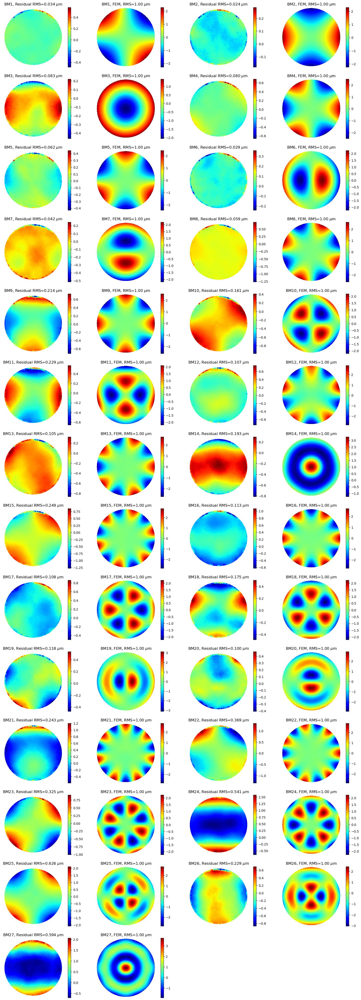

In [81]:
#This takes ~ minutes to run
from scipy.interpolate import LinearNDInterpolator 

nfitmode = 162
xtalk = np.zeros((nfitmode, endmode))

nrow = np.max((int(np.ceil(nmode/2.)),2)) #minimum 2 rows, or ax[irow][icol] won't work
fig, ax = plt.subplots(nrow,4,figsize=(20,4*nrow))
i = 0
for modeID in range(startmode,endmode+1):
    irow = np.int8(i/4)
    icol = np.mod(i,4)
    i += 1

    bm2d = np.squeeze(myBM[:,:,modeID-1-startmode+1]) #myBM is already in M1B, in nm; myBM already has signs match GMT FEM
    mask = ~np.isnan(bm2d)

    interp = LinearNDInterpolator(list(zip(x1[mask], y1[mask])), bm2d[mask], fill_value=0)
    mapOntoMLFEgrid = interp(nodex_ml, nodey_ml).ravel()
    sign_MLBM_GMT_padded = np.pad(np.tile(sign_MLBM_GMT,(UMat_ml.shape[0],1)), 
       ((0, 0), (0, nfitmode - sign_MLBM_GMT.shape[0])), mode='constant', constant_values=1.0)    
    xtalk[:,modeID-1] = (sign_MLBM_GMT_padded*UMat_ml[:,:nfitmode]).transpose() / UMat_ml.shape[0]  @ mapOntoMLFEgrid #all in micron
    #residual = mapOntoMLFEgrid - UMat_ml[:,:nfitmode] @ xtalk[:, modeID-1] #this is residual in micron
    #only subtract that one mode
    residual = mapOntoMLFEgrid - (sign_MLBM_GMT[modeID-1]*UMat_ml[:,modeID-1]) * xtalk[modeID-1, modeID-1] #this is residual in micron

    m1rms = np.std(residual[~np.isnan(residual)]) #in micron
    mytitle = r'BM%d, Scaling =%.3f, Residual RMS = %.3f micron (per 1 micron RMS expected)'%(modeID, 
                                                                        np.max(xtalk[:,modeID-1]),
                                                                        m1rms)
    print(mytitle)
    img = ax[irow][icol].scatter(nodex_ml, nodey_ml, 10, residual)
    fig.colorbar(img, ax=ax[irow][icol])
    mytitle = r'BM%d, Residual RMS=%.3f $\mu$m'%(modeID, m1rms)

    ax[irow][icol].set_title(mytitle)
    ax[irow][icol].axis('off')
    
    ###
    irow = np.int8(i/4)
    icol = np.mod(i,4)
    i += 1
    
    if not GMT_FEM: #ML FEM
        aa = UMat_ml[:,modeID-1]
        m1rms = np.std(aa[~np.isnan(aa)])
        grid_z = griddata((np.squeeze(nodex_ml), np.squeeze(nodey_ml)), 
                          sign_MLBM_GMT[modeID-1]*UMat_ml[:,modeID-1], (x1,y1), method='linear')
    else: #never tried yet
        ss_mlgrid = Afn_ml @ gmt165Fvec2mlFvec(VMat[:,modeID-1]) * 1e-3
        m1rms = np.std(ss_mlgrid[~np.isnan(ss_mlgrid)])
        grid_z = griddata((np.squeeze(nodex_ml), np.squeeze(nodey_ml)), ss_mlgrid, (x1,y1), method='linear')
    #img = ax[irow][icol].scatter(nodex, nodey,10, UMat[:,modeID-1]) #scatter makes image sampling bad
    img = ax[irow][icol].imshow(grid_z, origin='lower')
    
    ax[irow][icol].set_title(r'BM%d, FEM, RMS=%.2f $\mu$m'%(modeID,m1rms))
    ax[irow][icol].axis('equal')
    ax[irow][icol].axis('off')
    fig.colorbar(img, ax=ax[irow][icol])
    
for i in range(nmode, nrow*4):
    irow = np.int8(i/4)
    icol = np.mod(i,4)
    ax[irow][icol].axis('off')
print('scaling factor <1 means mirror stiffer than FEM, i.e., model too soft.')

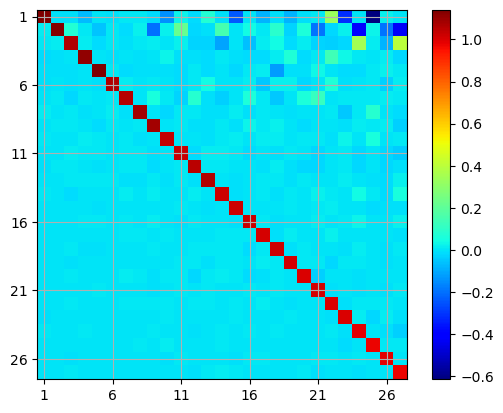

In [82]:
xtalk_sqaure = xtalk[:endmode, :]
plt.imshow(xtalk_sqaure)
rows, cols = xtalk_sqaure.shape
i = 5
plt.xticks(ticks=np.arange(0,cols,i), labels=np.arange(1, cols + 1,i))
plt.yticks(ticks=np.arange(0,rows,i), labels=np.arange(1, rows + 1,i))
plt.grid()
plt.colorbar();

01, +0.012
02, -0.010
03, +0.073
04, -0.069
05, -0.053
06, -0.011
07, +0.016
08, +0.023
09, -0.199
10, -0.148
11, +0.217
12, +0.081
13, +0.078
14, +0.150
15, -0.239
16, -0.062
17, -0.084
18, -0.126
19, -0.082
20, +0.061
21, -0.195
22, +0.326
23, -0.313
24, -0.406
25, -0.615
26, -0.191
27, -0.425


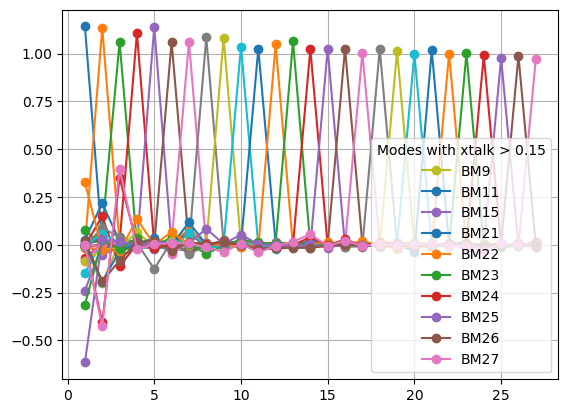

In [130]:
aa = xtalk_sqaure.copy()
np.fill_diagonal(aa,0)
thres = 0.15
maxx = np.zeros(endmode)
for modeID in range(startmode, endmode+1):
    labelstr = ''
    maxx[modeID-1] = aa[np.argmax(np.abs(aa[:, modeID-1])), modeID-1]
    if (np.abs(maxx[modeID-1])>thres):
        labelstr = 'BM%d'%modeID
    plt.plot(range(1,endmode+1),xtalk_sqaure[:,modeID-1],'-o', label=labelstr);
    print('%02d, %+.3f'%(modeID, maxx[modeID-1]  ))
plt.legend(title='Modes with xtalk > %.2f'%thres, loc='lower right')
#plt.title()
#plt.plot(range(1,nfitmode+1),xtalk,'-o');
plt.grid();

Text(0.5, 1.0, 'Largest crosstalk coefficent of each bending mode')

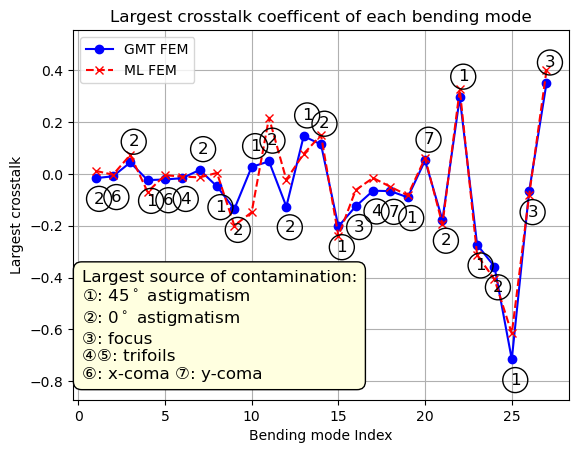

In [132]:
gmt_maxx, contamiID, scaleF = np.loadtxt('../model_data/GMT_max_xtalk.txt', unpack=True)
fig, ax = plt.subplots()
plt.plot(np.arange(1,endmode+1), gmt_maxx, '-bo',label='GMT FEM')
ml_maxx = np.zeros_like(gmt_maxx)
for i in range(endmode):
    ml_maxx[i] = xtalk_sqaure[int(contamiID[i])-1, i]
    if gmt_maxx[i]>0:
        yoffset = 0.08
    else:
        yoffset = -0.08
    plt.text(i+1+0.2, gmt_maxx[i]+yoffset, '%d'%contamiID[i], fontsize=12, ha="center", va="center",
        bbox=dict(boxstyle="circle", facecolor="none", edgecolor="black"))
plt.plot(np.arange(1,endmode+1), ml_maxx, '--rx', label='ML FEM')
plt.legend()
y1, y2 = ax.get_ylim()
ax.set_ylim(y1-0.1, y2+0.1)
plt.grid()
text = r"""Largest source of contamination:
①: 45$^\circ$ astigmatism 
②: 0$^\circ$ astigmatism
③: focus
④⑤: trifoils
⑥: x-coma ⑦: y-coma"""

ax.text(0.2, -0.8, text, fontsize=12, ha="left", va="bottom", 
        bbox=dict(facecolor="lightyellow", edgecolor="black", boxstyle="round,pad=0.5"))
plt.xlabel('Bending mode Index')
plt.ylabel('Largest crosstalk')
plt.title('Largest crosstalk coefficent of each bending mode')

In [124]:
repeats.shape

(2,)

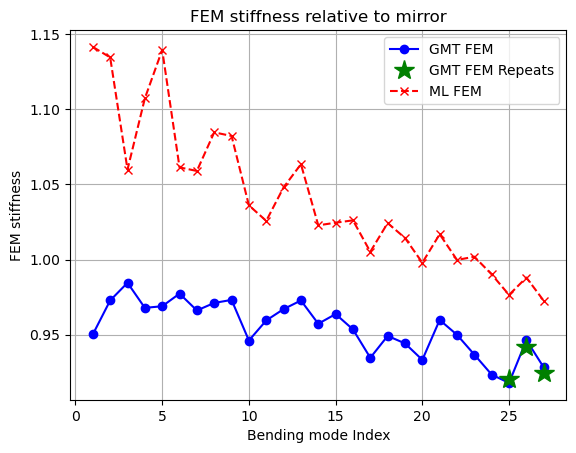

In [129]:
repeats = np.loadtxt('../model_data/GMT_stiffness_repeat.txt')

plt.plot(np.arange(1, endmode+1), scaleF, '-bo',label='GMT FEM')
plt.plot(np.arange(25, 27+1), repeats, 'g*',label='GMT FEM Repeats', markersize=15)
plt.plot(np.arange(1, endmode+1), np.diag(xtalk_sqaure), '--rx', label='ML FEM')
plt.xlabel('Bending mode Index')
plt.ylabel('FEM stiffness')
plt.title('FEM stiffness relative to mirror')
plt.legend()
plt.grid();

# change this modeID to see coeff for an individual mode

In [87]:
modeID = 27

BM 27
max = +0.40
min = -0.43


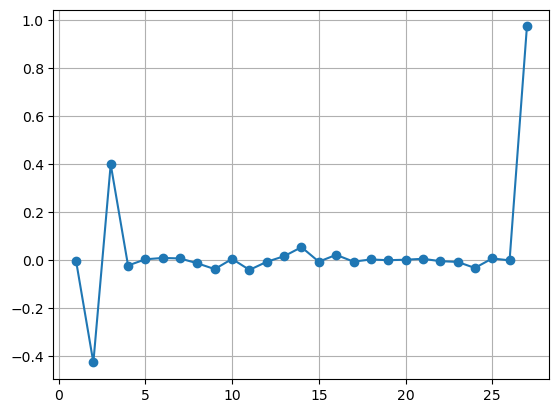

In [88]:
plt.plot(range(1,endmode+1),xtalk_sqaure[:,modeID-1],'-o');
#plt.plot(range(1,nfitmode+1),xtalk[:,modeID-1],'-o');
plt.grid();
aa = xtalk_sqaure[:,modeID-1].copy()
print('BM %d'%modeID)
aa[aa>0.8] = 0
print('max = %+.2f'%aa[np.argmax(aa)])
print('min = %+.2f'%aa[np.argmax(-aa)])

In [56]:
np.argmax(-aa[aa<0.8])+1

1

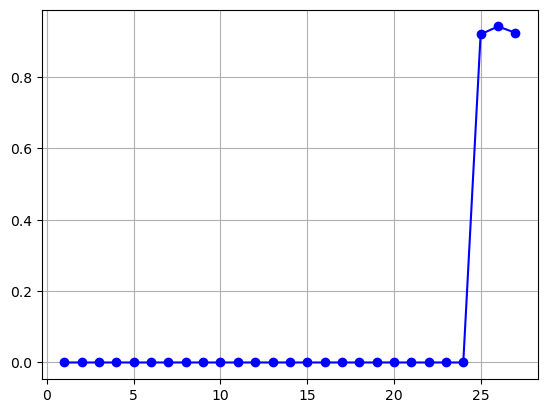

In [57]:
plt.plot(np.arange(1, endmode+1), np.diag(xtalk), '-bo')
plt.grid();

### Check T

In [58]:
t1 = (modeID-endmode)*4-4 #these are indices for locating the timestamps
t2 = t1+1
t3 = t1+2
t4 = t1+3
print(ts_array[t1], '\n', ts_array[t2], '\n', ts_array[t3], '\n', ts_array[t4])

Mon Jan 27 13:10:36 2025 
 Mon Jan 27 13:14:50 2025 
 Mon Jan 27 13:18:14 2025 
 Mon Jan 27 13:22:32 2025


----------------   Mon Jan 27 13:10:36 2025
m1_s1_thermal_ctrl/i/tc_temperature/value
2025-01-27 13:10:36  duration =  100  s
(1, 6, 32)
(1, 192)
----------------   Mon Jan 27 13:14:50 2025
m1_s1_thermal_ctrl/i/tc_temperature/value
2025-01-27 13:14:50  duration =  100  s
(1, 6, 32)
(1, 192)
----------------   Mon Jan 27 13:18:14 2025
m1_s1_thermal_ctrl/i/tc_temperature/value
2025-01-27 13:18:14  duration =  100  s
(1, 6, 32)
(1, 192)
----------------   Mon Jan 27 13:22:32 2025
m1_s1_thermal_ctrl/i/tc_temperature/value
2025-01-27 13:22:32  duration =  100  s
(1, 6, 32)
(1, 192)


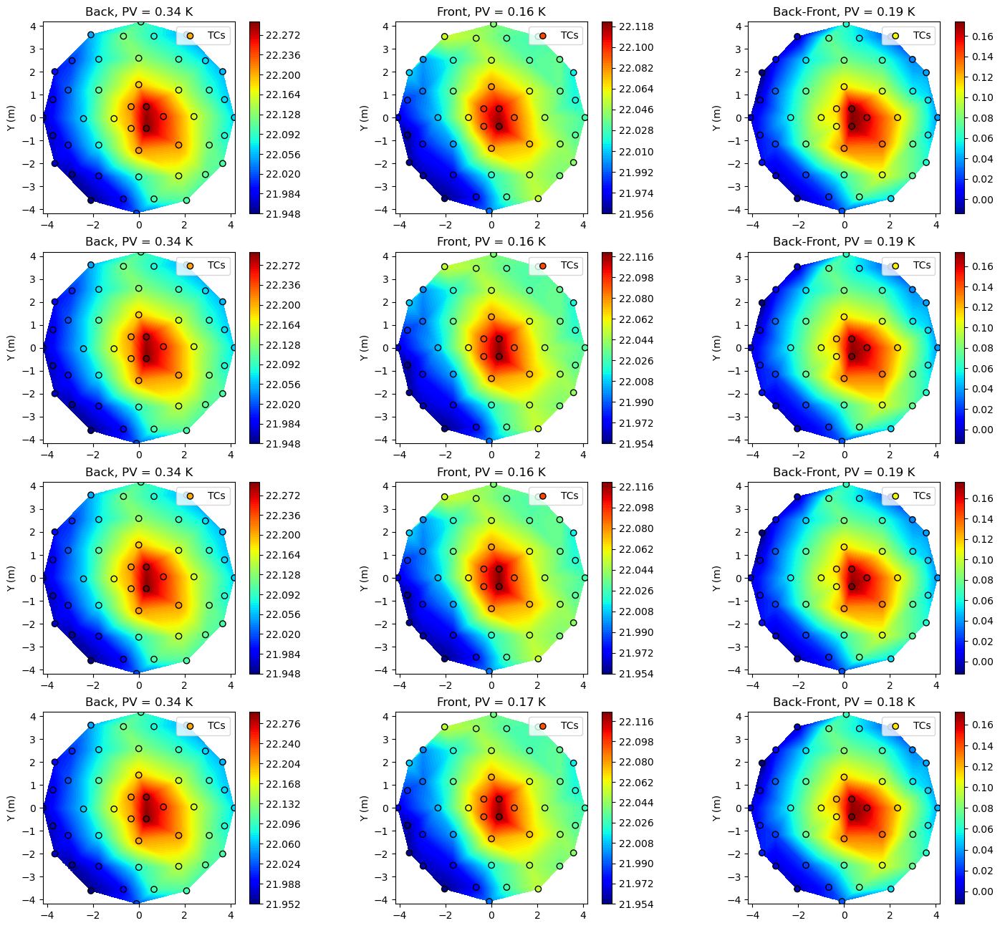

In [59]:
showTMaps([ts_array[t1], ts_array[t2], ts_array[t3], ts_array[t4]])

### Measurement noise?

In [60]:
#for 1um of bm25, we see 0.72um of bm1
print("for 377nm of bm25 measured, there were %.0f nm bm1 produced"%(0.72*377))
print("if this much bm1 were also present due to measurement noise, scaling factor for bm1 would have been %.2f"%(
(500+271)/500))

for 377nm of bm25 measured, there were 271 nm bm1 produced
if this much bm1 were also present due to measurement noise, scaling factor for bm1 would have been 1.54


### Check force telemetry: force differential

In [61]:
print(t1, t2)
sa_force1, tt = getDBData(unix_ts(ts_array[t1])-120,'m1_s1_support_ctrl/s/sa_force/value', duration_in_s=120, samples=120)
sa_force1_z = np.mean(sa_force1,axis=0)[:,2]
print(sa_force1_z.shape)
sa_force2, tt = getDBData(unix_ts(ts_array[t2])-120,'m1_s1_support_ctrl/s/sa_force/value', duration_in_s=120, samples=120)
sa_force2_z = np.mean(sa_force2,axis=0)[:,2]
print(sa_force2_z.shape)
sa_force3, tt = getDBData(unix_ts(ts_array[t3])-120,'m1_s1_support_ctrl/s/sa_force/value', duration_in_s=120, samples=120)
sa_force3_z = np.mean(sa_force3,axis=0)[:,2]
print(sa_force3_z.shape)
sa_force4, tt = getDBData(unix_ts(ts_array[t4])-120,'m1_s1_support_ctrl/s/sa_force/value', duration_in_s=120, samples=120)
sa_force4_z = np.mean(sa_force4,axis=0)[:,2]
print(sa_force4_z.shape)

-12 -11
m1_s1_support_ctrl/s/sa_force/value
2025-01-27 13:08:36  duration =  120  s
(120, 170, 3)
(120, 170, 3)
(170,)
m1_s1_support_ctrl/s/sa_force/value
2025-01-27 13:12:50  duration =  120  s
(120, 170, 3)
(120, 170, 3)
(170,)
m1_s1_support_ctrl/s/sa_force/value
2025-01-27 13:16:14  duration =  120  s
(120, 170, 3)
(120, 170, 3)
(170,)
m1_s1_support_ctrl/s/sa_force/value
2025-01-27 13:20:32  duration =  120  s
(120, 170, 3)
(120, 170, 3)
(170,)


In [62]:
expectedF = gmt165Fvec2gmt170Fvec(VMat[:, modeID-1])

input forces and output figure both in M1B


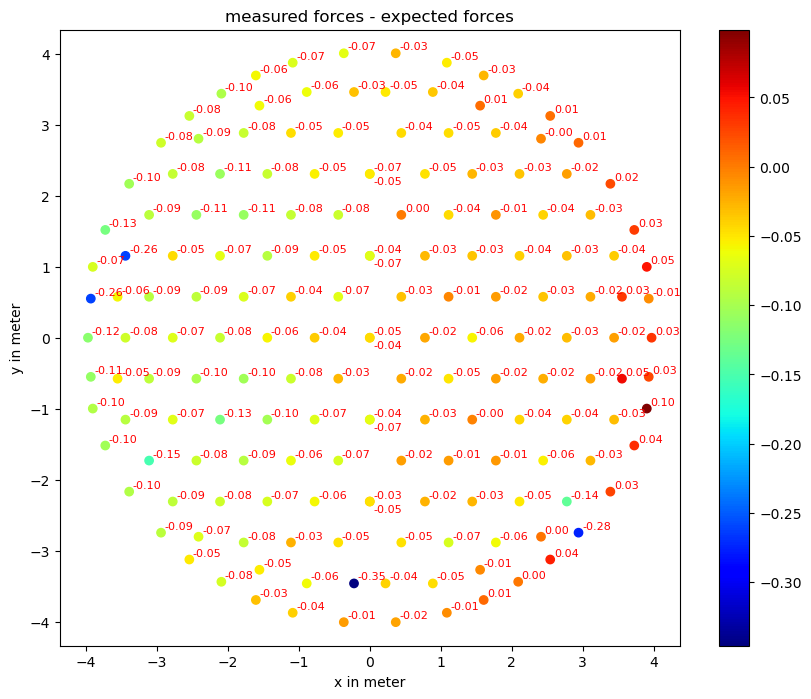

In [63]:
fdiff1 = (sa_force1_z-sa_force2_z)/2 - expectedF*bmMags[modeID-1]
showForceMap_M1B(fdiff1, 'measured forces - expected forces', precision=2)
#showForceMap_M1B(expectedF*bmMags[modeID-1], 'bb')

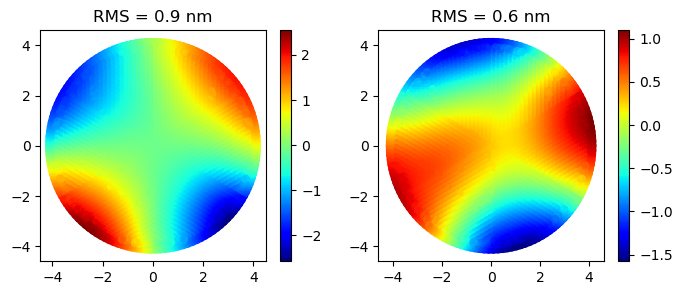

In [64]:
fdiff2 = (sa_force4_z-sa_force3_z)/2 - expectedF*bmMags[modeID-1]

fig, ax = plt.subplots(1,2, figsize=(8,3))
sdiff1 = Afz @ gmt170Fvec2gmt165Fvec(fdiff1)*1e9 #convert to nm
img = ax[0].scatter(nodex, nodey, 10,  sdiff1)
aarms = np.nanstd(sdiff1)
ax[0].set_title('RMS = %.1f nm'%aarms)
ax[0].axis('equal')
fig.colorbar(img, ax=ax[0])
sdiff2 = Afz @ gmt170Fvec2gmt165Fvec(fdiff2)*1e9 #convert to nm
img = ax[1].scatter(nodex, nodey, 10,  sdiff2)
aarms = np.nanstd(sdiff2)
ax[1].set_title('RMS = %.1f nm'%aarms)
fig.colorbar(img, ax=ax[1]);

In [65]:
##find the force command from DB
fcmd1, tt = getDBData(unix_ts(ts_array[t1])-120,'m1_s1_support_ctrl/i/sa_force_commanded/value', duration_in_s=120, samples=120)
fcmd2, tt = getDBData(unix_ts(ts_array[t2])-120,'m1_s1_support_ctrl/i/sa_force_commanded/value', duration_in_s=120, samples=120)
fcmd3, tt = getDBData(unix_ts(ts_array[t3])-120,'m1_s1_support_ctrl/i/sa_force_commanded/value', duration_in_s=120, samples=120)
fcmd4, tt = getDBData(unix_ts(ts_array[t4])-120,'m1_s1_support_ctrl/i/sa_force_commanded/value', duration_in_s=120, samples=120)

m1_s1_support_ctrl/i/sa_force_commanded/value
2025-01-27 13:08:36  duration =  120  s
(120, 170, 3)
(120, 170, 3)
m1_s1_support_ctrl/i/sa_force_commanded/value
2025-01-27 13:12:50  duration =  120  s
(120, 170, 3)
(120, 170, 3)
m1_s1_support_ctrl/i/sa_force_commanded/value
2025-01-27 13:16:14  duration =  120  s
(120, 170, 3)
(120, 170, 3)
m1_s1_support_ctrl/i/sa_force_commanded/value
2025-01-27 13:20:32  duration =  120  s
(120, 170, 3)
(120, 170, 3)


In [66]:
if 1:
    fdiff_inst_1 = sa_force1[:,:,2] - fcmd1[:,:,2]
    fdiff_inst_2 = sa_force2[:,:,2] - fcmd2[:,:,2]
    fdiff_inst_3 = sa_force3[:,:,2] - fcmd3[:,:,2]
    fdiff_inst_4 = sa_force4[:,:,2] - fcmd4[:,:,2]
else: #subtract initial forces in the 120 time perids    
    sa_force1[:,:,2] -= np.tile(sa_force1[0,:,2],(sa_force1.shape[0],1))
    sa_force2[:,:,2] -= np.tile(sa_force2[0,:,2],(sa_force2.shape[0],1))
    sa_force3[:,:,2] -= np.tile(sa_force3[0,:,2],(sa_force3.shape[0],1))
    sa_force4[:,:,2] -= np.tile(sa_force4[0,:,2],(sa_force4.shape[0],1))

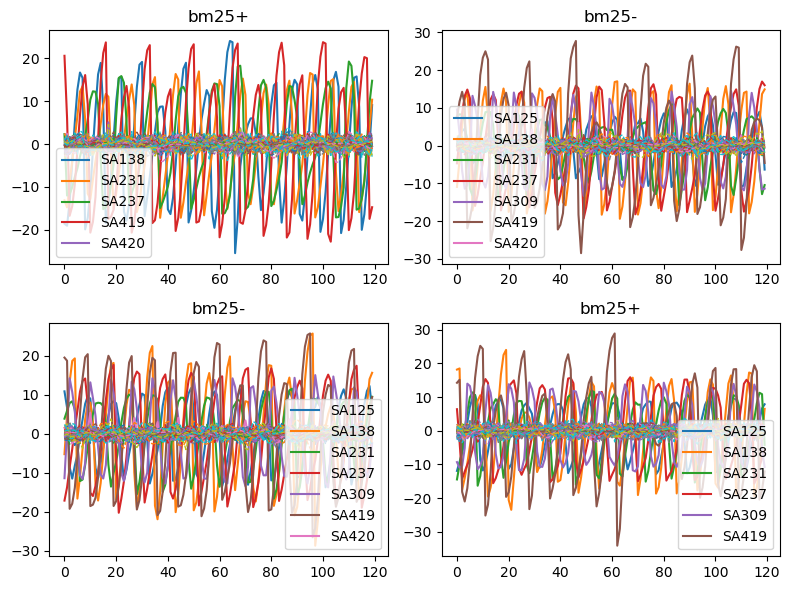

In [67]:
fig, ax = plt.subplots(2,2, figsize=(8,6))

for k in range(4):
    irow = np.int8(k//2)
    icol = np.mod(k,2)
    if k==0:
        fol_err = fdiff_inst_1 
    elif k==1:
        fol_err = fdiff_inst_2
    elif k==2:
        fol_err = fdiff_inst_3
    elif k==3:
        fol_err = fdiff_inst_4

    thres = 5
    for i in range(nact):
        if np.max(np.abs(fol_err[:,i]))>thres:
            ax[irow][icol].plot(fol_err[:,i], label='SA%s'%(saID[i+1]))
    ax[irow][icol].legend()
    ax[irow][icol].set_title('bm%d%s'%(modeID, signshort[k]))
    for i in range(nact):
        if np.max(np.abs(fol_err[:,i]))<=thres:
            ax[irow][icol].plot(fol_err[:,i], '--', linewidth=1)
plt.tight_layout()

In [68]:
print(np.mean(fdiff_inst_1[:,saID==231], axis=0))

[0.02153778]


In [69]:
max_idx = np.unravel_index(np.argmax(fdiff_inst_1), fdiff_inst_1.shape)
worst_shape = (Afz@gmt170Fvec2gmt165Fvec(fdiff_inst_1[max_idx[0],:]))*1e6 #turn m into micron
worst_coeff = UMat[:,:nfitmode].transpose() / UMat.shape[0]  @ worst_shape #all in micron

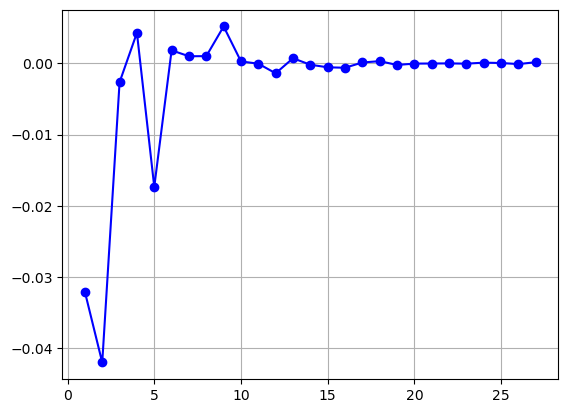

In [70]:
plt.plot(np.arange(1,27+1), worst_coeff[:27], '-bo')
plt.grid();

more investigations that can be done to gain more insights.

1. take the largest instantaneous force difference, and turn into bending modes. That shows the worst case
2. shift the 120s back by a few seconds, like, 3s, 5s, 8s, and check the force difference.
3. Dave also suggested to turn T change into bending modes and see the impact. The easist thing to do there would be to ask Will to process those surface maps with T compensation.

In [71]:
fol_err1, tt = getDBData(unix_ts(ts_array[t1])-120,'m1_s1_support_ctrl/o/sa_following_error/value', duration_in_s=120, samples=120)
fol_err2, tt = getDBData(unix_ts(ts_array[t2])-120,'m1_s1_support_ctrl/o/sa_following_error/value', duration_in_s=120, samples=120)
fol_err3, tt = getDBData(unix_ts(ts_array[t3])-120,'m1_s1_support_ctrl/o/sa_following_error/value', duration_in_s=120, samples=120)
fol_err4, tt = getDBData(unix_ts(ts_array[t4])-120,'m1_s1_support_ctrl/o/sa_following_error/value', duration_in_s=120, samples=120)

m1_s1_support_ctrl/o/sa_following_error/value
2025-01-27 13:08:36  duration =  120  s
(120, 170, 3)
(120, 170, 3)
m1_s1_support_ctrl/o/sa_following_error/value
2025-01-27 13:12:50  duration =  120  s
(120, 170, 3)
(120, 170, 3)
m1_s1_support_ctrl/o/sa_following_error/value
2025-01-27 13:16:14  duration =  120  s
(120, 170, 3)
(120, 170, 3)
m1_s1_support_ctrl/o/sa_following_error/value
2025-01-27 13:20:32  duration =  120  s
(120, 170, 3)
(120, 170, 3)


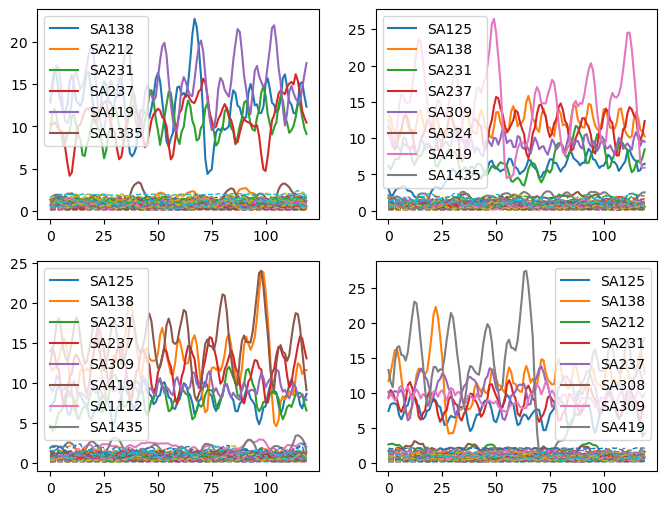

In [72]:
fig, ax = plt.subplots(2,2, figsize=(8,6))

for k in range(4):
    irow = np.int8(k//2)
    icol = np.mod(k,2)
    if k==0:
        fol_err = fol_err1
    elif k==1:
        fol_err = fol_err2
    elif k==2:
        fol_err = fol_err3
    elif k==3:
        fol_err = fol_err4

    thres = 2.5
    for i in range(nact):
        if np.max(fol_err[:,i,2])>=thres:
            ax[irow][icol].plot(fol_err[:,i,2], label='SA%s'%(saID[i+1]))
    ax[irow][icol].legend();
    for i in range(nact):
        if np.max(fol_err[:,i,2])<thres:
            ax[irow][icol].plot(fol_err[:,i,2], '--', linewidth=1)


In [230]:
previousH5 = unix_ts(ts_array[t1-1])
currentH5 = unix_ts(ts_array[t1])
duration_in_s = currentH5 - previousH5
print('previous h5 timestamp (bm%d+) = '%(modeID-1),ts_array[t1-1], previousH5)
print('current h5 timestamp (bm%d+)= '%modeID, ts_array[t1], currentH5)
print('duration = ', duration_in_s, ' seconds')

client = MongoClient(HOST, PORT)
tele = client.gmt_tele_1.tele_events

table_name = "m1_s1_support_ctrl/i/sa_force_commanded/value"
records = tele.find({"ts":{"$gt":previousH5*1000000000.0,"$lt":currentH5*1000000000.0},
                 "src":{"$eq":f"{table_name}"}})
#for record in records:
#    print(record['value'])
print('number of records = ', len(list(records)))

previous h5 timestamp (bm26+) =  Tue Jan 21 16:16:23 2025 1737501383
current h5 timestamp (bm27+)=  Tue Jan 21 16:20:33 2025 1737501633
duration =  250  seconds
number of records =  2500


### force command vs what we wanted to apply

27 -4 command_1737501402.txt
(165,)
1 1737501633


Text(0.5, 1.0, 'bending force command - what should be appled')

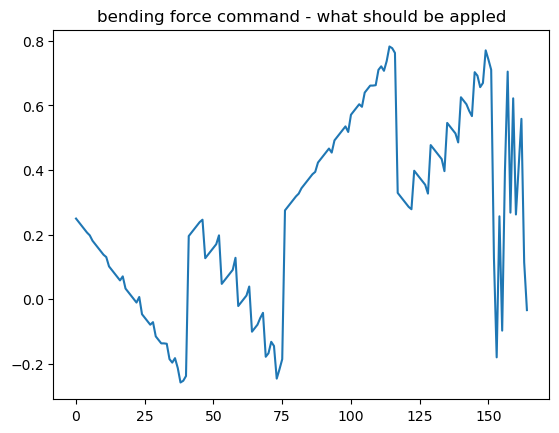

In [116]:
df = pd.read_csv(ml_data_dir+'/../../initial_optimized_forces.txt', header=None)
fpart2 = np.array(df[1])
filename = find_cmd_file(ml_data_dir+ "/../../cmd_logs/", unix_ts(ts_array[t1]))
print(modeID, t1, filename.split('/')[-1])
df = pd.read_csv(filename, header=None)
mlbfp1 = np.array(df[1])
print(mlbfp1.shape)

mysign = 1
if np.mod(t1,4)==2 or np.mod(t1,4)==1:
    mysign = -1
print(mysign, unix_ts(ts_array[t1]))
plt.plot(mlbfp1-fpart2-mysign*VMat[:,modeID-1]*bmMags[modeID-1])
plt.title('bending force command - what should be appled')

### what we sent to ML vs what we wanted to apply

27 initial_optimized_forces_bm27_p180.txt
(165,)


Text(0.5, 1.0, 'bending force command - what should be appled')

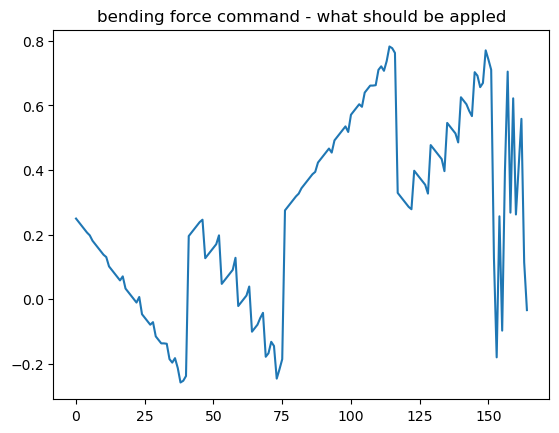

In [117]:
mysign = 'p'

df = pd.read_csv(ml_data_dir+'/../../initial_optimized_forces.txt', header=None)
fpart2 = np.array(df[1])

filename = glob.glob(ml_data_dir+'/../../section_10/initial_optimized_forces_bm%d_%s%d.txt'%(
    modeID,mysign, bmMags[modeID-1]*1000))[0]
print(modeID, filename.split('/')[-1])
df = pd.read_csv(filename, header=None)
mlbfp2 = np.array(df[1])
print(mlbfp2.shape)

if mysign=='p':
    mysign = 1
else:
    mysign = -1
plt.plot(mlbfp2-fpart2-mysign*VMat[:,modeID-1]*bmMags[modeID-1])
plt.title('bending force command - what should be appled')

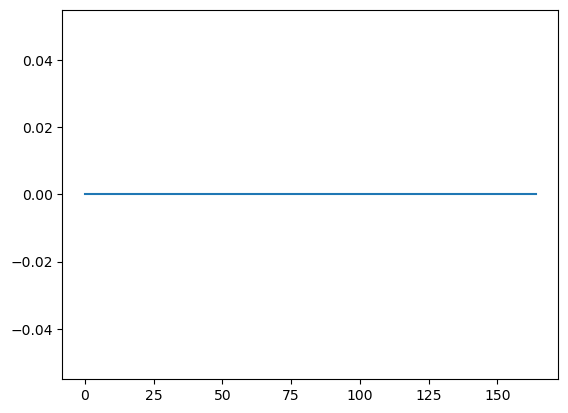

In [118]:
plt.plot(mlbfp2-mlbfp1);

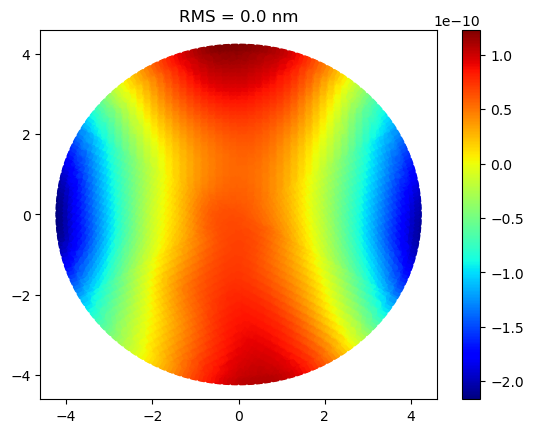

In [59]:
fdiff = mlbfp2-fpart2-mysign*VMat[:,modeID-1]*bmMags[modeID-1]
aa = Afz @ fdiff*1e9 #convert to nm
plt.scatter(nodex, nodey, 10,  aa)
aarms = np.nanstd(aa)
plt.title('RMS = %.1f nm'%aarms)
plt.colorbar();

input forces and output figure both in M1B


0.2836339953075466

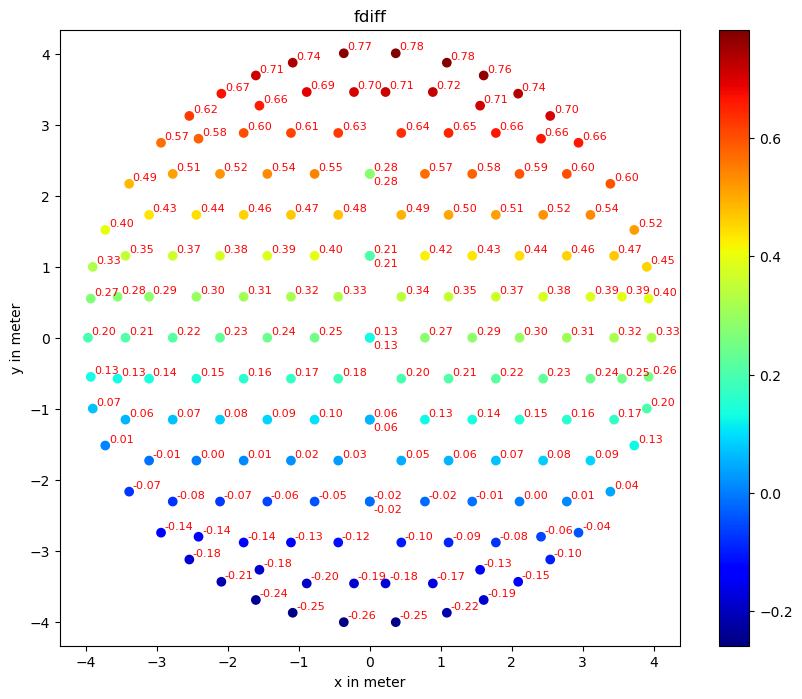

In [60]:
showForceMap_M1B(gmt165Fvec2gmt170Fvec(fdiff),'fdiff', precision=2)
np.nanstd(fdiff)

In [ ]:
aa.shape